### 2381203 - Kametay Turar - Coursework - April 30, 2024

### Land Cover Detection using Aerial Imagery

This report presents a comparative study of two advanced machine learning models, Convolutional Neural Networks (CNN) and Support Vector Machines (SVM), applied to the UC Merced Land Use dataset. This dataset includes 21 distinct land cover types, each represented by 100 images, providing a comprehensive basis for evaluating model effectiveness in classifying high-dimensional spatial data.

#### Importing Libraries and Functions

In [44]:
# Importing necessary libraries and modules for the project
import numpy as np  # For numerical operations and manipulation of data
import cv2  # For image processing tasks
import matplotlib.pyplot as plt  # For plotting graphs and displaying images
from sklearn.model_selection import train_test_split  # For splitting the data into train, validation, and test sets
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam 
from tensorflow.keras.regularizers import l2 
from tensorflow.keras.utils import to_categorical  # For converting labels to one-hot encoding
from tensorflow.keras.models import Sequential  # For building the neural network layers in a sequential fashion
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout  # Importing specific layers and functions for CNN
from sklearn.utils import shuffle  # For shuffling data to ensure random distribution
from skimage.feature import hog  # For extracting Histogram of Oriented Gradients (HOG) features from images
from tqdm import tqdm  # For displaying progress bars during operations
from sklearn.svm import SVC  # For using Support Vector Machine classifier
from sklearn.metrics import classification_report, confusion_matrix  # For evaluating model performance
from sklearn.preprocessing import StandardScaler  # For standardizing features by removing the mean and scaling to unit variance
from sklearn.decomposition import PCA  # For performing principal component analysis for dimensionality reduction


## Convolutional neural network (CNN) - 21 classes

The Convolutional Neural Network (CNN) is tailored for image classification with a dataset comprising low-resolution images divided into 21 distinct classes. The primary objective of this model is to accurately classify images into one of these categories, utilizing a deep learning framework that leverages spatial hierarchies in data through convolutions.

#### 1. Loading and Preprocessing Data

In [45]:
# Load image data and corresponding labels
X_low_res = np.load('DS_Xdata.npy')  
Y = np.load('Ydata.npy') 

# Normalize image data
X_low_res = X_low_res.astype('float32') / 255.0

# Convert labels to one-hot encoded format suitable for classification
Y = to_categorical(Y)

# Shuffle the dataset to ensure the data is randomly distributed
indices = np.random.permutation(len(Y))
X_low_res, Y = X_low_res[indices], Y[indices]

# Split the dataset into training (80%), validation(10%), and testing(10%) sets
X_train, X_temp, Y_train, Y_temp = train_test_split(X_low_res, Y, test_size=0.2, random_state=42,shuffle=True)
X_val, X_test, Y_val, Y_test = train_test_split(X_temp, Y_temp, test_size=0.5, random_state=42, shuffle=True)

# Print the shape of the datasets to verify the splits
print("Training split:", X_train.shape)
print("Validation split:", X_val.shape)
print("Testing split:", X_test.shape)


Training split: (1680, 61, 61, 3)
Validation split: (210, 61, 61, 3)
Testing split: (210, 61, 61, 3)


#### 2. Data Augmentation

In [46]:
# Define parameters for data augmentation to enhance model robustness
data_gen = ImageDataGenerator(
    featurewise_center=False,
    samplewise_center=False,
    featurewise_std_normalization=False,
    samplewise_std_normalization=False,
    zca_whitening=False,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    channel_shift_range=0.,
    fill_mode='nearest',
    cval=0.,
    horizontal_flip=True,
    vertical_flip=False,
    rescale=None,
    preprocessing_function=None,
    data_format=None,
)

# Create a training data generator instance for real-time data augmentation
train_generator = data_gen.flow(X_train, Y_train, batch_size=40)

#### 3. Defining and Training the CNN Model

In [47]:
model = Sequential()
model.add(Conv2D(32, (3, 3), padding='SAME', input_shape=(61, 61, 3), activation='relu'))
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(64, (3, 3), padding='SAME', activation='relu'))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Flatten())
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(21, activation='softmax'))

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model using the augmented data generator
history = model.fit(train_generator, epochs=100, validation_data=(X_val, Y_val))


Epoch 1/100


/opt/anaconda3/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/opt/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


42/42 ━━━━━━━━━━━━━━━━━━━━ 7s 144ms/step - accuracy: 0.0475 - loss: 3.0450 - val_accuracy: 0.1238 - val_loss: 2.9056
Epoch 2/100
42/42 ━━━━━━━━━━━━━━━━━━━━ 6s 139ms/step - accuracy: 0.1179 - loss: 2.8053 - val_accuracy: 0.1619 - val_loss: 2.7385
Epoch 3/100
42/42 ━━━━━━━━━━━━━━━━━━━━ 6s 132ms/step - accuracy: 0.1699 - loss: 2.5864 - val_accuracy: 0.2571 - val_loss: 2.4792
Epoch 4/100
42/42 ━━━━━━━━━━━━━━━━━━━━ 6s 134ms/step - accuracy: 0.2628 - loss: 2.2799 - val_accuracy: 0.2524 - val_loss: 2.5817
Epoch 5/100
42/42 ━━━━━━━━━━━━━━━━━━━━ 6s 136ms/step - accuracy: 0.3085 - loss: 2.1868 - val_accuracy: 0.3429 - val_loss: 2.2311
Epoch 6/100
42/42 ━━━━━━━━━━━━━━━━━━━━ 6s 140ms/step - accuracy: 0.3292 - loss: 2.0430 - val_accuracy: 0.4048 - val_loss: 1.8138
Epoch 7/100
42/42 ━━━━━━━━━━━━━━━━━━━━ 6s 138ms/step - accuracy: 0.3665 - loss: 1.8988 - val_accuracy: 0.3619 - val_loss: 2.1368
Epoch 8/100
42/42 ━━━━━━━━━━━━━━━━━━━━ 6s 139ms/step - accuracy: 0.3820 - loss: 1.8514 - val_accuracy: 0.3714

#### 4. Evaluate the Model

In [48]:
# Evaluate the model on the training, validation, and test datasets to obtain loss and accuracy
train_loss, train_acc = model.evaluate(X_train, Y_train)
val_loss, val_acc = model.evaluate(X_val, Y_val)
test_loss, test_acc = model.evaluate(X_test, Y_test)

# Print out the loss and accuracy for each dataset split
print("Accuracy Results:")
print(f"Training Set Accuracy: {train_acc* 100:.4f}%")
print(f"Testing Set Accuracy: {test_acc* 100:.4f}%")
print(f"Validation Set Accuracy: {val_acc* 100:.4f}%")


53/53 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - accuracy: 0.9063 - loss: 0.2510
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - accuracy: 0.8166 - loss: 0.7346
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - accuracy: 0.8455 - loss: 0.6895
Accuracy Results:
Training Set Accuracy: 90.7143%
Testing Set Accuracy: 82.3810%
Validation Set Accuracy: 80.9524%


The CNN model demonstrates high accuracy on both testing and validation sets, indicating effective learning and generalization from the training data. The slightly higher accuracy on the testing set suggests that the model is well-tuned and the data augmentation strategies are effective. The results confirm the capability of CNNs to handle complex image-based classification tasks with high accuracy. However it may need some improvements as Training Set Accuracy is way higher than the Testing and Validation 

#### 5. Plot Training and Validation Curves

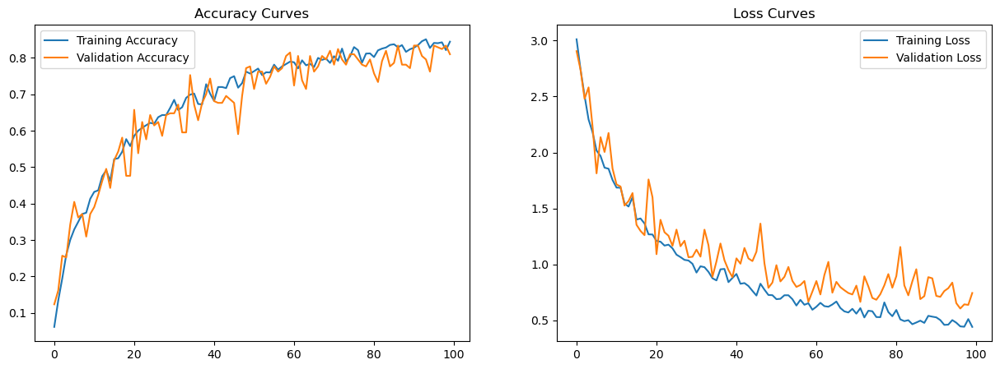

In [49]:
# Plot the accuracy and loss curves to visualize the training progress
plt.figure(figsize=[15, 5])
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curves')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curves')
plt.legend()
plt.show()


#### 6. Classification Report and Confusion Matrix

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Classification Report:
               precision    recall  f1-score   support

     Class 1       0.92      0.80      0.86        15
     Class 2       0.90      1.00      0.95         9
     Class 3       0.86      1.00      0.92         6
     Class 4       1.00      1.00      1.00         9
     Class 5       0.54      0.78      0.64         9
     Class 6       0.94      1.00      0.97        15
     Class 7       0.56      1.00      0.71         5
     Class 8       0.56      0.83      0.67         6
     Class 9       1.00      1.00      1.00         6
    Class 10       1.00      0.80      0.89        10
    Class 11       1.00      1.00      1.00        16
    Class 12       0.40      1.00      0.57         6
    Class 13       0.67      0.50      0.57        12
    Class 14       0.78      1.00      0.88         7
    Class 15       0.86      0.67      0.75         9
    Class 16       0.77      1.00      0.87        10
    Class 17       

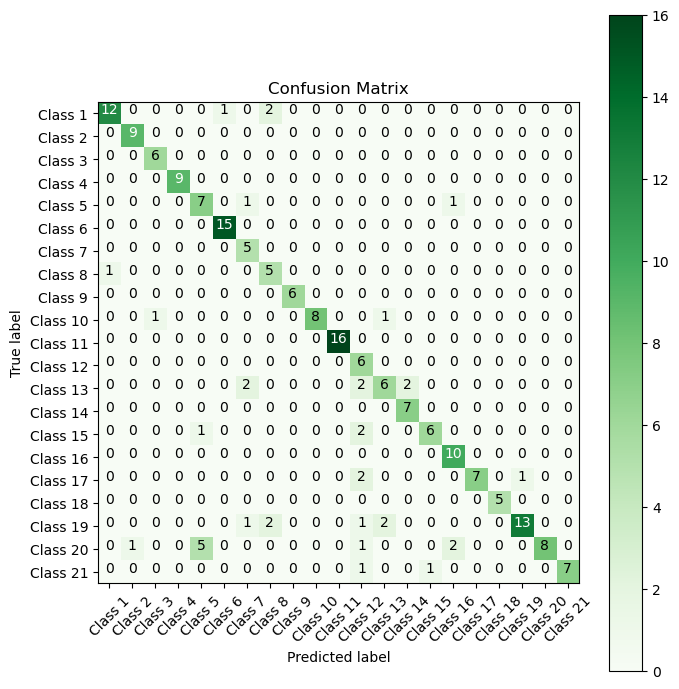

In [50]:
# Predicting classes for the test set
Y_pred = model.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_test = np.argmax(Y_test, axis=1)

# Generate and print the classification report detailing precision, recall, and f1-score
class_report = classification_report(Y_test, Y_pred_classes, target_names=[f"Class {i+1}" for i in range(21)])
print("Classification Report:\n", class_report)

# Calculate and visualize the confusion matrix
cm = confusion_matrix(Y_test, Y_pred_classes)
class_names = [f"Class {i+1}" for i in range(21)]
plt.figure(figsize=(7, 7))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names, rotation=45)
plt.yticks(tick_marks, class_names)
threshold = cm.max() / 2.
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        color = "white" if cm[i, j] > threshold else "black"
        plt.text(j, i, format(cm[i, j], 'd'),
                 horizontalalignment="center",
                 color=color)
plt.tight_layout()
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

#### 7. Visualization

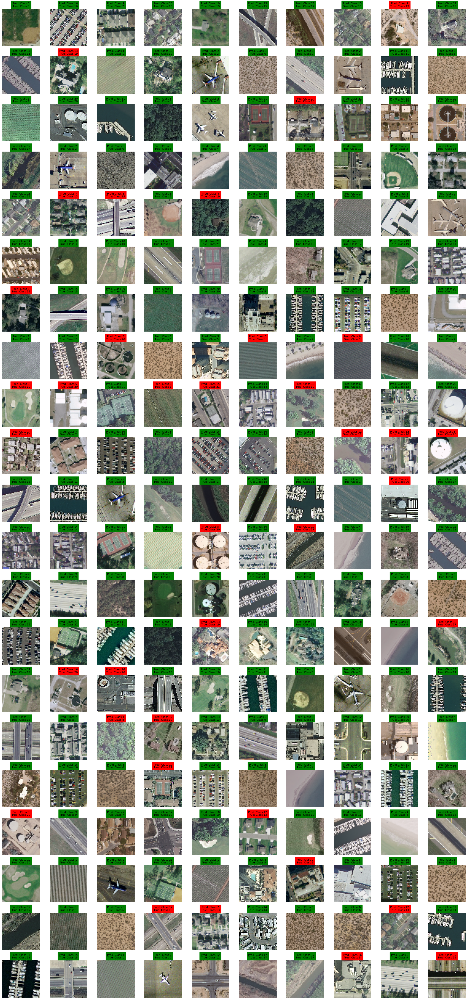

In [51]:
# Define a function to display predictions with visual cues on correctness
def display_predictions(images, true_labels, predicted_labels, class_names, num_images=210):  
    num_cols = 10
    num_rows = (num_images + num_cols - 1) // num_cols 
    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, 2 * num_rows))
    axes = axes.ravel() 

    for i in range(num_images):
        if i < len(images):
            ax = axes[i]
            ax.imshow(images[i])  # Assuming images are RGB or adjusted cmap if grayscale
            true_class = class_names[true_labels[i]]
            pred_class = class_names[predicted_labels[i]]
            title_text = f'Pred: {pred_class}\nTrue: {true_class}'
            title_color = 'red' if predicted_labels[i] != true_labels[i] else 'green'
            ax.set_title(title_text, fontsize=8, backgroundcolor=title_color)
            ax.axis('off')
        else:
            axes[i].axis('off')  # Hide unused axes

    plt.tight_layout()
    plt.show()

class_names = [f"Class {i+1}" for i in range(21)] 
display_predictions(X_test, Y_test, Y_pred_classes, class_names, num_images=210) 

## Support vector machine (SVM) - 21 classes


The Support Vector Machine (SVM) model was developed to categorize images into one of 21 classes, utilizing the robust feature extraction capabilities of Histogram of Oriented Gradients (HOG). The SVM can be accepted as well-suited for this task due to its effectiveness in handling high-dimensional data and its ability to model complex nonlinear decision boundaries with the use of kernel functions but its accuracy level will be discussed more in the report.

#### 1. Preprocessing and Feature Extraction

In [52]:
# Function to preprocess images and extract HOG features
def preprocess(xs):
    hog_imgs = []
    for x in tqdm(xs):
        # Convert image to grayscale to simplify the model and reduce computation
        gray = cv2.cvtColor(x, cv2.COLOR_RGB2GRAY) / 255.0
        # Extract HOG features, which capture gradient structure that is characteristic of local shape
        fd = hog(gray, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2), block_norm='L2-Hys')
        hog_imgs.append(fd)
    return np.array(hog_imgs)

def batch_process_feature_extraction(images, batch_size=100):
    # Process images in batches to manage memory consumption
    n_batches = len(images) // batch_size + (1 if len(images) % batch_size != 0 else 0)
    features = []
    for batch in range(n_batches):
        start = batch * batch_size
        end = start + batch_size
        batch_features = preprocess(images[start:end])
        features.append(batch_features)
    return np.concatenate(features, axis=0)

# Load and normalize images
X_low_res = np.load('DS_Xdata.npy').astype('float32') / 255.0
Y = np.load('Ydata.npy').flatten()

# Preserve a copy of original images for visualization purposes
X_test_original = X_low_res.copy()  

# Extract HOG features from the entire dataset
X_features = batch_process_feature_extraction(X_low_res, batch_size=100) 

# Split the data into training, validation, and testing sets
X_train, X_temp, Y_train, Y_temp = train_test_split(X_features, Y, test_size=0.2, random_state=42, shuffle=True)
X_val, X_test, Y_val, Y_test = train_test_split(X_temp, Y_temp, test_size=0.5, random_state=42, shuffle=True)

# Additionally, split original images to correspond with the HOG feature splits
X_train_orig, X_temp_orig = train_test_split(X_test_original, test_size=0.2, random_state=42, shuffle=True)
X_val_orig, X_test_orig = train_test_split(X_temp_orig, test_size=0.5, random_state=42, shuffle=True)

# Display the shape of training, validation, and testing splits for both HOG features and original images
print("Training split (HOG features):", X_train.shape)
print("Validation split (HOG features):", X_val.shape)
print("Testing split (HOG features):", X_test.shape)
print("Training split (Original images):", X_train_orig.shape)
print("Validation split (Original images):", X_val_orig.shape)
print("Testing split (Original images):", X_test_orig.shape)


100%|██████████| 100/100 [00:00<00:00, 2062.61it/s]


Training split (HOG features): (1680, 1296)
Validation split (HOG features): (210, 1296)
Testing split (HOG features): (210, 1296)
Training split (Original images): (1680, 61, 61, 3)
Validation split (Original images): (210, 61, 61, 3)
Testing split (Original images): (210, 61, 61, 3)


#### 2. Model Training and Evaluation

In [53]:
# Standardize features by removing the mean and scaling to unit variance
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_val = scaler.transform(X_val)
X_test = scaler.transform(X_test)

# Reduce dimensionality of the data to retain 95% of the variance, simplifying the model and potentially improving performance
pca = PCA(n_components=0.95)
X_train = pca.fit_transform(X_train)
X_val = pca.transform(X_val)
X_test = pca.transform(X_test)

# Train an SVM classifier with a radial basis function kernel and regularization parameter C=10
svm_model = SVC(kernel='rbf', C=10, cache_size=2000)
svm_model.fit(X_train, Y_train)

# Evaluate the model on validation and test sets
train_accuracy = svm_model.score(X_train, Y_train)
val_accuracy = svm_model.score(X_val, Y_val)
test_accuracy = svm_model.score(X_test, Y_test)
print(f"Training Set Accuracy: {train_accuracy:.4%}")
print(f"Test Set Accuracy: {test_accuracy:.4%}")
print(f"Validation Set Accuracy: {val_accuracy:.4%}")


Training Set Accuracy: 100.0000%
Test Set Accuracy: 61.9048%
Validation Set Accuracy: 55.2381%


The SVM, while generally robust, shows lower performance compared to the CNN. This outcome might be due to the inherent limitations of using HOG features alone, which may not capture all the necessary information for distinguishing among 21 different classes. The SVM's performance could potentially be improved by tuning hyperparameters further or using a combination of different feature types that might capture more aspects of the images. But it has fullfilled its purpose as to compare with CNN

#### 3. Classification Report and Confusion Matrix

Classification Report (Test Set):
              precision    recall  f1-score   support

           0       0.82      0.75      0.78        12
           1       0.57      0.67      0.62         6
           2       0.80      0.75      0.77        16
           3       0.73      0.62      0.67        13
           4       0.80      0.31      0.44        13
           5       0.70      0.93      0.80        15
           6       0.31      0.40      0.35        10
           7       0.44      0.80      0.57         5
           8       0.83      0.83      0.83        12
           9       0.25      0.33      0.29         6
          10       0.80      0.67      0.73         6
          11       0.70      0.88      0.78         8
          12       0.38      0.43      0.40         7
          13       0.55      0.43      0.48        14
          14       0.89      0.62      0.73        13
          15       0.31      0.50      0.38         8
          16       0.57      0.57      0.57    

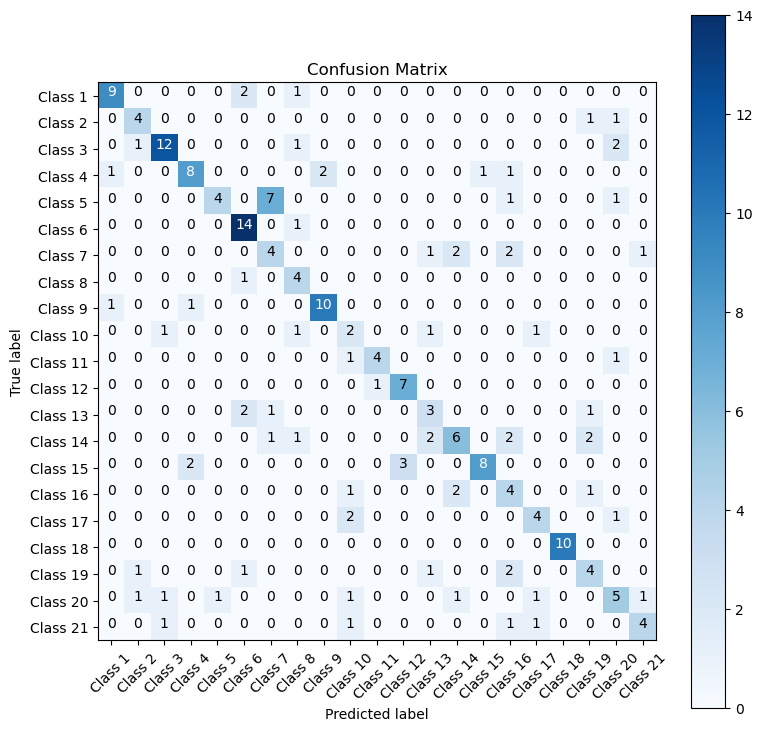

In [54]:
# Predict the classes on the test set and generate a classification report
Y_pred = svm_model.predict(X_test)
print("Classification Report (Test Set):")
print(classification_report(Y_test, Y_pred))

# Compute and display the confusion matrix to evaluate model's classification performance across all classes
cm = confusion_matrix(Y_test, Y_pred)
plt.figure(figsize=(9, 9))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
class_names = [f"Class {i+1}" for i in range(np.max(Y)+1)]  # Adjust class names based on maximum label in Y
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names, rotation=45)
plt.yticks(tick_marks, class_names)
# Add text annotations with contrast for readability
threshold = cm.max() / 2.
for i, j in np.ndindex(cm.shape):
    plt.text(j, i, format(cm[i, j], 'd'), horizontalalignment="center", color="white" if cm[i, j] > threshold else "black")
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

#### 4. Visualization

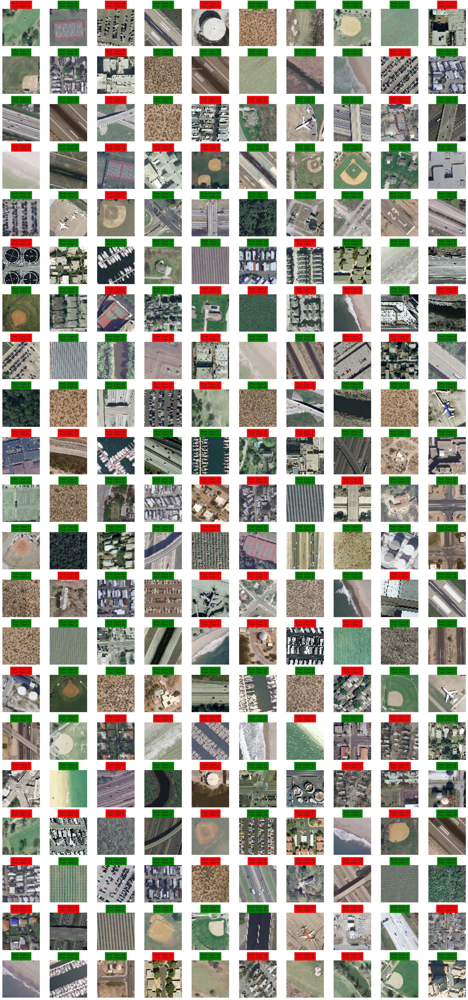

In [55]:
# Ensure class_names array covers all classes for visualization
class_names = [f"Class {i}" for i in range(1, 22)]

# Display predictions using a custom function
display_predictions(X_test_orig, Y_test, Y_pred, class_names, num_images=210)

#### Summary


The experiments underscore the strengths of CNNs in handling complex image classification tasks, leveraging their deep architecture to capture intricate patterns in data. In contrast, the SVM's reliance on manually extracted features and its linear nature (even with non-linear kernels) places it at a disadvantage for high-dimensional image data, evident from the lower accuracy scores.

## Convolutional neural network (CNN) - 5 classes - Lower number of classes

Reducing the number of classes in a classification problem can simplify the task, leading to improved model accuracy, faster training times, and better manageability, especially when classes are very similar or there's limited data. Fewer classes can also help address data imbalances and make the model's decisions easier to interpret, which is crucial in fields requiring explainability.

#### 1. Loading and Preprocessing Data

In [98]:
# Load the low-resolution images and labels from the dataset
X_low_res = np.load('DS_Xdata.npy') 
Y = np.load('Ydata.npy').flatten()  # Corresponding labels for the images, flattened to ensure it is a 1D array

num_of_classes = 5  # Defining the number of unique classes for classification

# Shuffle the dataset to ensure random distribution of data
indices = np.random.permutation(len(Y))
X_low_res, Y = X_low_res[indices], Y[indices]

# Normalize the pixel values of the images to a range of 0 to 1
X_low_res = X_low_res.astype('float32') / 255.0

# Randomly select 5 classes for the classification task
np.random.seed(42)
selected_classes = np.random.choice(np.unique(Y), num_of_classes, replace=False)
print("Selected classes for the subset:", selected_classes)

# Filter the dataset to only include images from the selected classes
is_selected_class = np.isin(Y, selected_classes)
X_selected = X_low_res[is_selected_class]
Y_selected = Y[is_selected_class]

# Remap the selected class labels to a new range from 0 to 4
new_class_labels = {original: new for new, original in enumerate(selected_classes)}
Y_selected_mapped = np.array([new_class_labels[class_label] for class_label in Y_selected])

# Split the data into training, validation, and testing sets
X_train, X_temp, Y_train_mapped, Y_temp_mapped = train_test_split(X_selected, Y_selected_mapped, test_size=0.2, random_state=42, shuffle=True)
X_val, X_test, Y_val_mapped, Y_test_mapped = train_test_split(X_temp, Y_temp_mapped, test_size=0.5, random_state=42, shuffle=True)

# One-hot encode the labels for use in the CNN
Y_train = to_categorical(Y_train_mapped, num_classes=num_of_classes)
Y_val = to_categorical(Y_val_mapped, num_classes=num_of_classes)
Y_test = to_categorical(Y_test_mapped, num_classes=num_of_classes)

# Output the shapes of the splits to verify correct partitioning
print("Training split:", X_train.shape)
print("Validation split:", X_val.shape)
print("Testing split:", X_test.shape)


Selected classes for the subset: [ 0 17 15  1  8]
Training split: (400, 61, 61, 3)
Validation split: (50, 61, 61, 3)
Testing split: (50, 61, 61, 3)


#### 2. Data Augmentation and Model Definition

In [99]:
# Data Augmentation
data_gen = ImageDataGenerator(
    featurewise_center=False,
    samplewise_center=False,
    featurewise_std_normalization=False,
    samplewise_std_normalization=False,
    zca_whitening=False,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    channel_shift_range=0.,
    fill_mode='nearest',
    cval=0.,
    horizontal_flip=True,
    vertical_flip=False,
    rescale=None,
    preprocessing_function=None,
    data_format=None,
)

#Defining a training generator
train_generator = data_gen.flow(X_train, Y_train, batch_size=8)

# Construct a convolutional neural network architecture
model = Sequential()
model.add(Conv2D(32, (3, 3), padding='SAME', input_shape=(61, 61, 3), activation='relu'))
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(64, (3, 3), padding='SAME', activation='relu'))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Flatten())
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(num_of_classes, activation='softmax'))

# Compile the CNN model with Adam optimizer and categorical crossentropy loss function
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model using the augmented data generator
history = model.fit(train_generator, epochs=100, validation_data=(X_val, Y_val))


Epoch 1/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 3s 50ms/step - accuracy: 0.1772 - loss: 1.7523 - val_accuracy: 0.4400 - val_loss: 1.2890
Epoch 2/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 46ms/step - accuracy: 0.3525 - loss: 1.5092 - val_accuracy: 0.5800 - val_loss: 1.1859
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 47ms/step - accuracy: 0.4446 - loss: 1.3852 - val_accuracy: 0.6000 - val_loss: 0.9673
Epoch 4/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 45ms/step - accuracy: 0.4957 - loss: 1.2074 - val_accuracy: 0.5600 - val_loss: 0.8788
Epoch 5/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 45ms/step - accuracy: 0.5889 - loss: 1.1584 - val_accuracy: 0.6600 - val_loss: 0.7646
Epoch 6/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 45ms/step - accuracy: 0.5775 - loss: 1.0708 - val_accuracy: 0.6400 - val_loss: 0.8607
Epoch 7/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 47ms/step - accuracy: 0.5969 - loss: 1.0057 - val_accuracy: 0.6600 - val_loss: 0.7139
Epoch 8/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - accuracy: 0.6213 - loss: 0.9241 - val_accuracy: 0.

#### 3. Model Evaluation

In [100]:
# Evaluate the model's performance on the training, validation, and testing datasets
train_loss, train_acc = model.evaluate(X_train, Y_train)
val_loss, val_acc = model.evaluate(X_val, Y_val)
test_loss, test_acc = model.evaluate(X_test, Y_test)

# Print the performance metrics for each dataset split
print("Accuracy Results:")
print(f"Training Set Accuracy: {train_acc * 100:.4f}%")
print(f"Testing Set Accuracy: {test_acc * 100:.4f}%")
print(f"Validation Set Accuracy: {val_acc * 100:.4f}%")


13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.9961 - loss: 0.0119
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.9629 - loss: 0.0881
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - accuracy: 0.9867 - loss: 0.0371
Accuracy Results:
Training Set Accuracy: 99.5000%
Testing Set Accuracy: 98.0000%
Validation Set Accuracy: 96.0000%


#### 4. Visualization

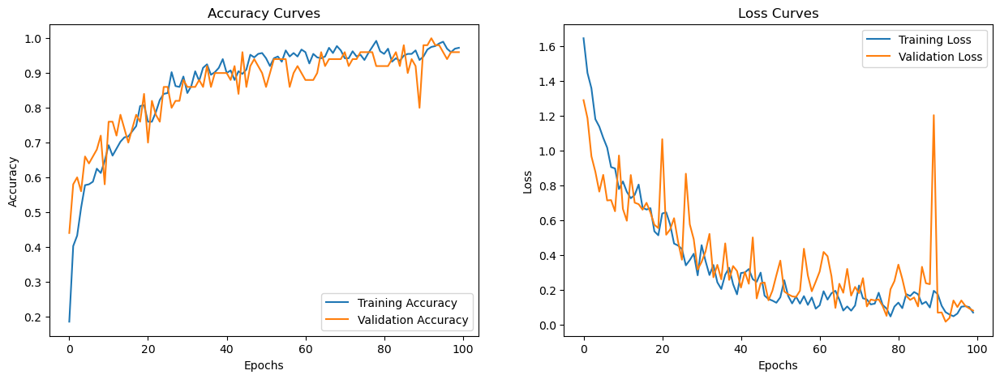

In [101]:
# Plot training and validation accuracy and loss over epochs to visualize learning progress
plt.figure(figsize=[15, 5])
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curves')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curves')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

#### 5. Classification Report and Confusion Matrix

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
Classification Report:
               precision    recall  f1-score   support

     Class 1       1.00      0.91      0.95        11
    Class 18       1.00      1.00      1.00        12
    Class 16       1.00      1.00      1.00        11
     Class 2       0.88      1.00      0.93         7
     Class 9       1.00      1.00      1.00         9

    accuracy                           0.98        50
   macro avg       0.97      0.98      0.98        50
weighted avg       0.98      0.98      0.98        50



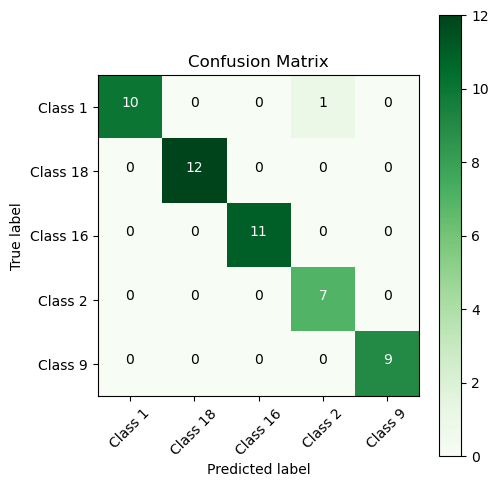

In [102]:
# Dictionary for reverse mapping from training labels to original labels
reverse_class_labels = {i: original for i, original in enumerate(selected_classes)}

# Predicting the classes for the test set
Y_pred = model.predict(X_test)
Y_pred_classes = np.argmax(Y_pred, axis=1)
Y_test = np.argmax(Y_test, axis=1)

# Map predicted and actual labels back to original class labels
Y_pred_original = np.array([reverse_class_labels[i] for i in Y_pred_classes])
Y_test_original = np.array([reverse_class_labels[i] for i in Y_test])

# Generating the classification report
class_report = classification_report(Y_test_original, Y_pred_original, target_names=[f"Class {reverse_class_labels[i]+1}" for i in range(num_of_classes)])
print("Classification Report:\n", class_report)

# Calculate the confusion matrix
cm = confusion_matrix(Y_test_original, Y_pred_original)
class_names = [f"Class {reverse_class_labels[i]+1}" for i in range(num_of_classes)]

# Visualizing the confusion matrix
plt.figure(figsize=(5, 5))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens)
plt.title('Confusion Matrix')
plt.colorbar()
tick_marks = np.arange(num_of_classes)
plt.xticks(tick_marks, class_names, rotation=45)
plt.yticks(tick_marks, class_names)
threshold = cm.max() / 2.

# Loop to add text annotations with contrast based on the threshold for visibility
for i, j in np.ndindex(cm.shape):
    color = "white" if cm[i, j] > threshold else "black"
    plt.text(j, i, format(cm[i, j], 'd'),
             horizontalalignment="center",
             color=color)

plt.tight_layout()
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()


## Support vector machine (SVM) - 5 classes

#### 1. Preprocessing and Feature Extraction

In [103]:
# Load data
X_low_res = np.load('DS_Xdata.npy').astype('float32') / 255.0  # Normalize the images when loading
Y = np.load('Ydata.npy').flatten()

# Randomly select 5 classes
np.random.seed(42)
unique_classes = np.unique(Y)
selected_classes = np.random.choice(unique_classes, 5, replace=False)
print("Selected classes:", selected_classes)

# Filter data for selected classes
indices = np.isin(Y, selected_classes)
X_selected = X_low_res[indices]
Y_selected = Y[indices]

# Map the selected class labels to {0, 1, 2, 3, 4}
new_labels = {class_label: i for i, class_label in enumerate(selected_classes)}
Y_selected = np.vectorize(new_labels.get)(Y_selected)

assert len(X_selected) == len(Y_selected), "Mismatch in features and labels count after filtering."

# Batch process the images and extract HOG features
X_features = batch_process_feature_extraction(X_selected)

# Split the feature data
X_train, X_temp, Y_train, Y_temp = train_test_split(X_features, Y_selected, test_size=0.2, random_state=42,shuffle=True)
X_val, X_test, Y_val, Y_test = train_test_split(X_temp, Y_temp, test_size=0.5, random_state=42, shuffle=True)

# Additionally, split original selected images in the same way
X_train_orig, X_temp_orig = train_test_split(X_selected, test_size=0.2, random_state=42)
X_val_orig, X_test_orig = train_test_split(X_temp_orig, test_size=0.5, random_state=42)

print("Training split (HOG features):", X_train.shape)
print("Validation split (HOG features):", X_val.shape)
print("Testing split (HOG features):", X_test.shape)
print("Training split (Original images):", X_train_orig.shape)
print("Validation split (Original images):", X_val_orig.shape)
print("Testing split (Original images):", X_test_orig.shape)


Selected classes: [ 0 17 15  1  8]


100%|██████████| 100/100 [00:00<00:00, 1940.50it/s]

Training split (HOG features): (400, 1296)
Validation split (HOG features): (50, 1296)
Testing split (HOG features): (50, 1296)
Training split (Original images): (400, 61, 61, 3)
Validation split (Original images): (50, 61, 61, 3)
Testing split (Original images): (50, 61, 61, 3)


#### 2. Model Training and Evaluation

In [104]:
# Standardize features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_val = scaler.transform(X_val)
X_test = scaler.transform(X_test)

# Train SVM with C=10
svm_model = SVC(kernel='rbf', C=10, cache_size=2000)
svm_model.fit(X_train, Y_train)

# Evaluate the model on validation and test sets
train_accuracy = svm_model.score(X_train, Y_train)
val_accuracy = svm_model.score(X_val, Y_val)
test_accuracy = svm_model.score(X_test, Y_test)
print(f"Training Set Accuracy: {train_accuracy:.4%}")
print(f"Test Set Accuracy: {test_accuracy:.4%}")
print(f"Validation Set Accuracy: {val_accuracy:.4%}")

Training Set Accuracy: 100.0000%
Test Set Accuracy: 96.0000%
Validation Set Accuracy: 90.0000%


#### 3. Classification Report and Confusion Matrix

Classification Report (Test Set):
               precision    recall  f1-score   support

     Class 1       1.00      0.93      0.96        14
    Class 18       1.00      0.86      0.92         7
    Class 16       0.83      1.00      0.91         5
     Class 2       1.00      1.00      1.00        14
     Class 9       0.91      1.00      0.95        10

    accuracy                           0.96        50
   macro avg       0.95      0.96      0.95        50
weighted avg       0.97      0.96      0.96        50



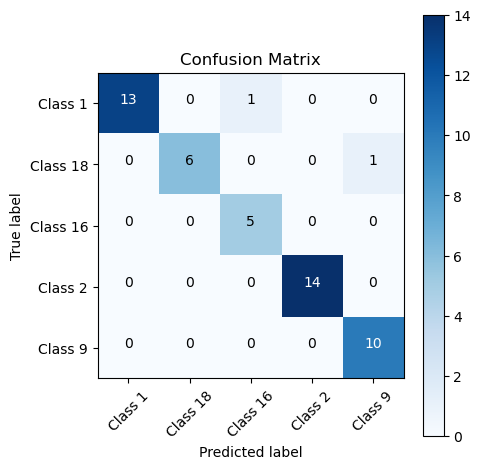

In [105]:
# Dictionary for reverse mapping from training labels to original labels
reverse_class_labels = {i: original for i, original in enumerate(selected_classes)}

# Predicting the classes for the test set
Y_pred = svm_model.predict(X_test)

# Map predicted and actual labels back to original class labels
Y_pred_original = np.array([reverse_class_labels[i] for i in Y_pred])
Y_test_original = np.array([reverse_class_labels[i] for i in Y_test])

# Generate and print the classification report detailing precision, recall, and f1-score for the original class labels
class_report = classification_report(Y_test_original, Y_pred_original, target_names=[f"Class {reverse_class_labels[i]+1}" for i in range(len(selected_classes))])
print("Classification Report (Test Set):\n", class_report)

# Calculate the confusion matrix for the original class labels
cm = confusion_matrix(Y_test_original, Y_pred_original)
class_names = [f"Class {reverse_class_labels[i]+1}" for i in range(len(selected_classes))]

# Visualize the confusion matrix using matplotlib
plt.figure(figsize=(5, 5))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names, rotation=45)
plt.yticks(tick_marks, class_names)
plt.ylabel('True label')
plt.xlabel('Predicted label')

# Text annotations with contrast based on the threshold for better visibility
threshold = cm.max() / 2.
for i, j in np.ndindex(cm.shape):
    color = "white" if cm[i, j] > threshold else "black"
    plt.text(j, i, format(cm[i, j], 'd'),
             horizontalalignment="center",
             color=color)

plt.tight_layout()
plt.show()


#### Overall Conclusion

These results not only reinforce the robustness of CNNs in handling complex and high-dimensional datasets but also highlight the need for careful consideration when applying SVMs to similar tasks. The analysis suggests that while SVMs can be tuned to perform better in less complex scenarios, CNNs generally offer more reliability and higher accuracy for comprehensive image classification tasks in remote sensing. This detailed evaluation provides clear insights into the practical applications of these models in land cover detection, guiding future research and application in enhancing model performance and adaptability in the evolving field of aerial imagery.